In [1]:
import pyga
import pickle
import random
from shape import ShapeOrig
from vae_dim import ShapeVAE
import numpy as np
import vae
import matplotlib.pyplot as plt
import torch

plt.rcParams['figure.figsize'] = [6, 4]

In [2]:
path = r'/Users/joshuahellewell/Desktop/02-msc/01-modules/MSc Project - 771952/03-results/data/shapes100k.pkl'

In [3]:
with open(path,'rb') as f:
    shapes = pickle.load(f)

random_indexes = random.sample(range(len(shapes)), 1000)


# Use those indexes to get the corresponding objects
random_subset = [ShapeOrig(shapes[i].points.flatten()) for i in random_indexes]

## Genetic Algorithm in the Original Dimensional Space
* No latent space representation provided.
* Shapes are defined simply by the coordinates (e.g., 10 points, 200 points in x,y)
* A random population of points is generated, for a specified resolution.

In [1123]:
population_size = 50
individuals = [ShapeOrig(np.random.uniform(-1, 1, size=200)) for _ in range(population_size)]

In [1124]:
# population_size = 100
# individuals = [ShapeOrig(np.random.normal(loc=0.0, scale=1.0, size=10)) for _ in range(population_size)]

In [1125]:
population = pyga.Population(individuals)

**Inital Population**
* Before allowing the genetic algorithm to run, the initial population is simply a random selection of node coordinates in 2D space.
* The genetic algorithm will compute the fitness, that is the compactness of each shape in the initial population, and perform crossover and mutation to evolve towards an improved compactness value.

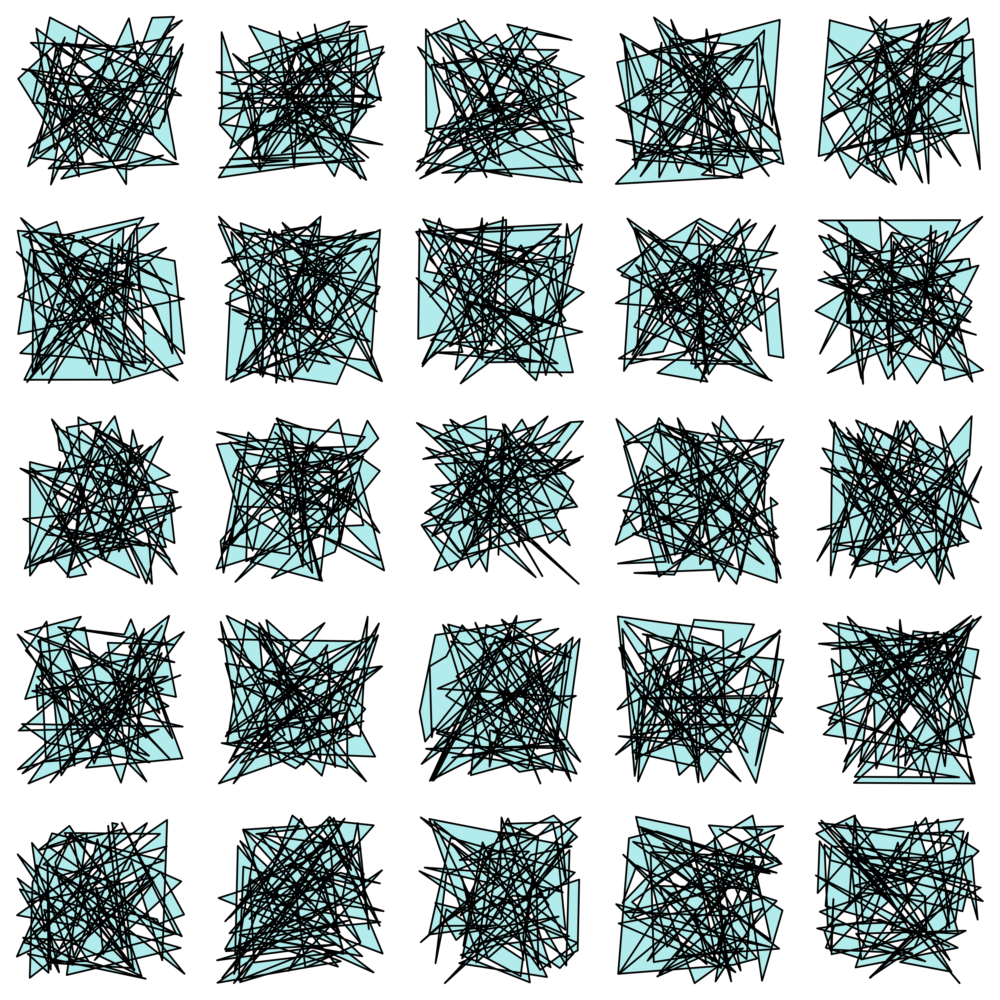

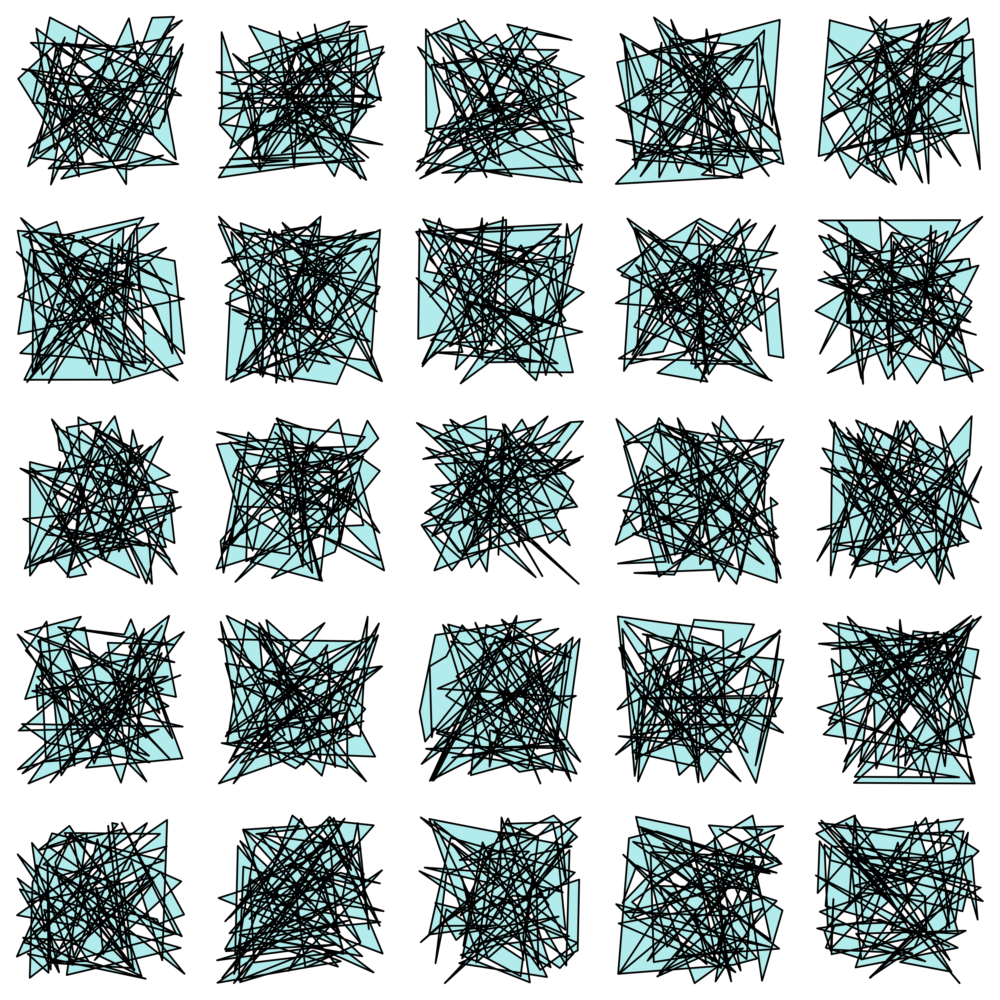

In [1126]:
population.plot()

**Genetic Algorithm Setup**
* Number of generations = 1000. (i.e., the number of times a population is allowed to evolve)
* Number of parents - the number of indvidiual selected for to be evolved into the next generation.
* Mutation probability - the % chance of a gene in each individual to be randomly mutated. This helps to explore beyond the original population selection.

In [1127]:
ga = pyga.GeneticAlgorithm(population, 
                           num_generations=100, 
                           num_parents=10, 
                           mutation_probability=0.05, 
                           animate=False)

In [1128]:
ga.evolve()

Evolution: 100%|██████████| 100/100 [00:01<00:00, 61.49it/s]


**Fitness**
* The maximum fitness of all shapes in the population of a generation is determined and plotted over the generations.


np.float64(0.011122051707244368)

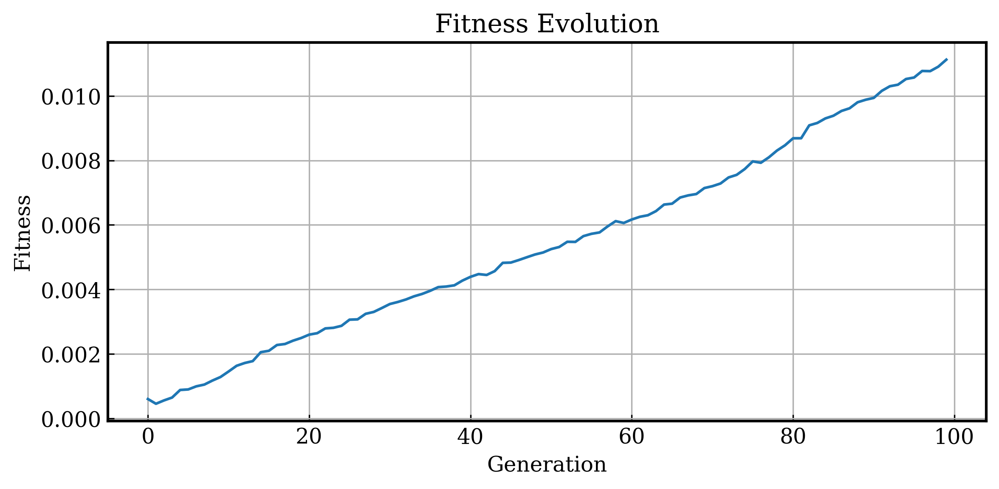

In [1129]:
ga.plot_fitness()
np.array(population.fitness).max()

**Optimised Shape Design**
* The final population is visualised after the GA has run.
* The ideal shape for compactness should somewhat resemble a circle, however, factors such as initial design space complexity, number of initial individuals, number of generations will effect the success of the final population in meeting the fitness objective.

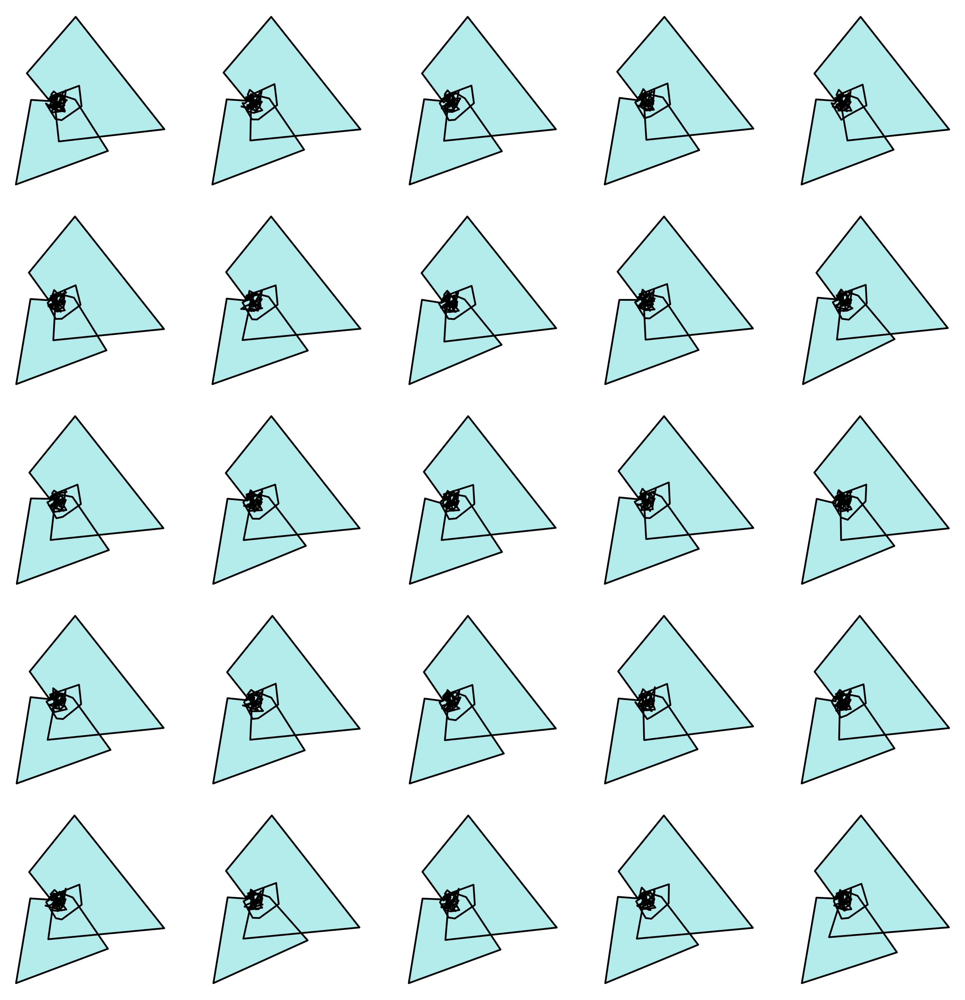

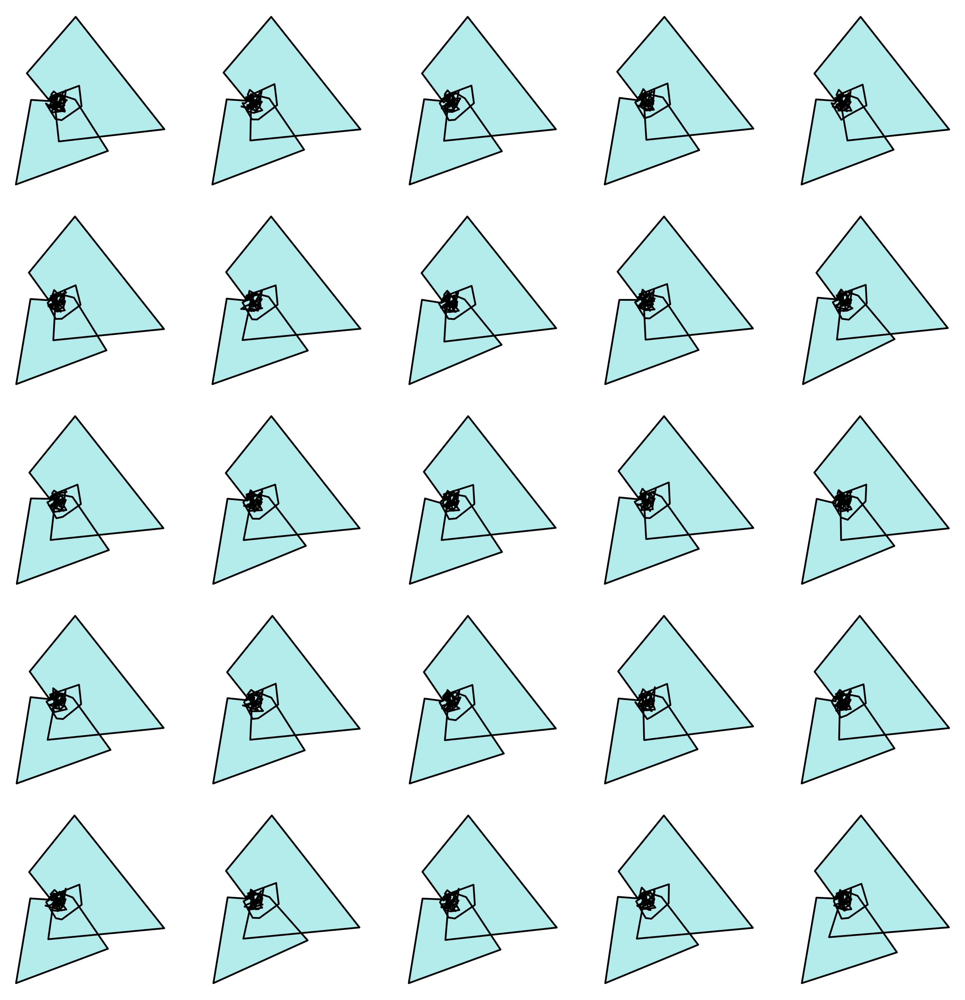

In [1130]:
population.plot()

## Genetic Algorithm in the Reduced Dimension Latent Space

**VAE Model**
* Load an existing, trained VAE model for representing shapes in low-dimensional latent form.
* VAE is used to generate hhigh-resolution 2D shapes, which would otherwise be described by a high-number of design variables (nodes).

In [1131]:
model_path = r'/Users/joshuahellewell/Desktop/02-msc/01-modules/MSc Project - 771952/03-results/models/24042025_training/model_005/vae_epoch_1000_mse4249.6.pt'
model = torch.load(model_path)
ShapeVAE.set_model(model)

/var/folders/g6/cp4y9yrj70746qd9t6j1yj2r0000gn/T/ipykernel_24465/948313332.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(model_path)


In [1132]:
model

VAE(
  (encoder): Sequential(
    (0): Linear(in_features=400, out_features=256, bias=True)
    (1): ReLU()
    (2): Linear(in_features=256, out_features=128, bias=True)
    (3): ReLU()
  )
  (fc_mu): Linear(in_features=128, out_features=6, bias=True)
  (fc_logvar): Linear(in_features=128, out_features=6, bias=True)
  (decoder): Sequential(
    (0): Linear(in_features=6, out_features=128, bias=True)
    (1): ReLU()
    (2): Linear(in_features=128, out_features=256, bias=True)
    (3): ReLU()
    (4): Linear(in_features=256, out_features=400, bias=True)
  )
)

**Existing Shape Data**
* As part of the VAE trained, 100k shapes were generated with resolution of 200 points.
* The shapes are saved as a .pickle file, and are access below as a list of class objects.

In [1020]:
with open(path,'rb') as f:
    shapes = pickle.load(f)

random_indexes = random.sample(range(len(shapes)), 200)

# Use those indexes to get the corresponding objects
random_subset = [ShapeVAE(shapes[i].points.flatten(),model) for i in random_indexes]

sh = [torch.tensor(shape.genes, dtype = torch.float32).view(-1) for shape in random_subset]

**Random Latent Shape Generation**
* Using the distribution of latent values, create a set of random latent values to reconstruct high-dimensional shapes.

In [1097]:
population_size = 100

individuals = [ShapeVAE(np.random.uniform(-3, 3, size=6)) for _ in range(population_size)]

In [1077]:
population = pyga.Population(individuals)

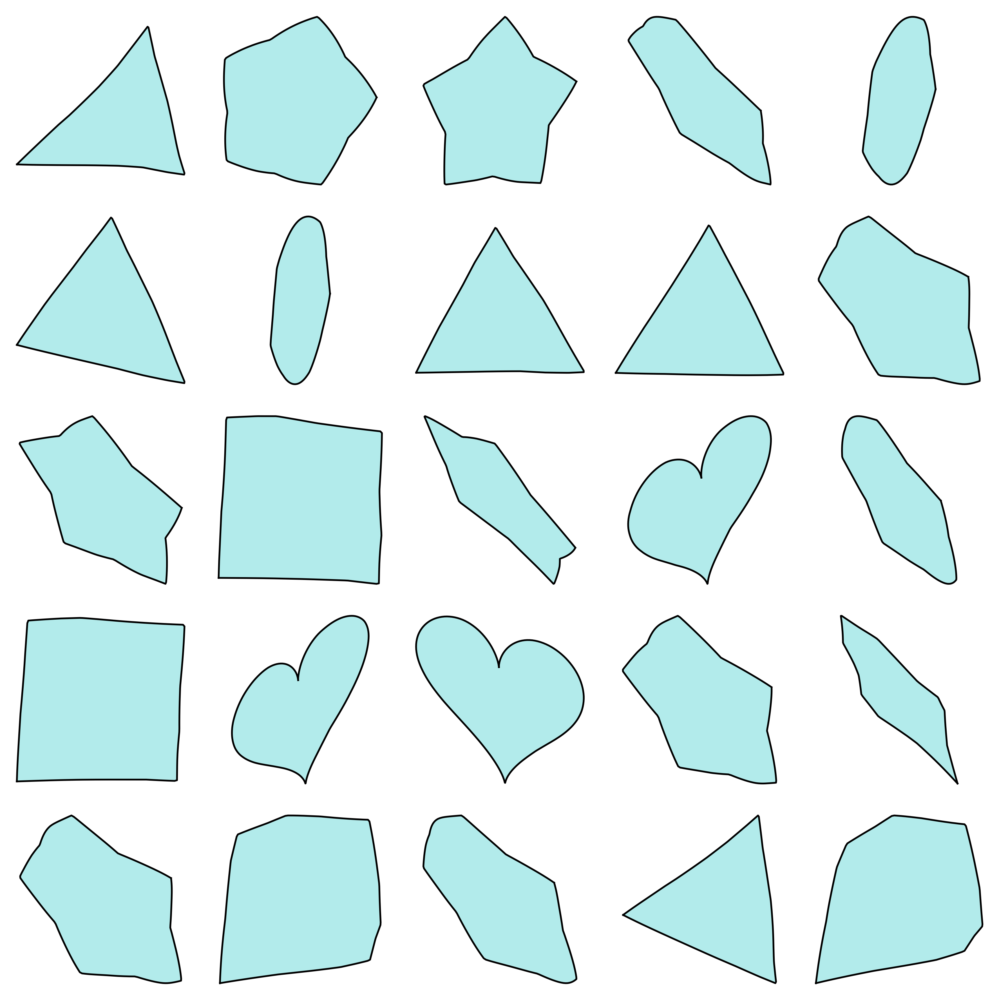

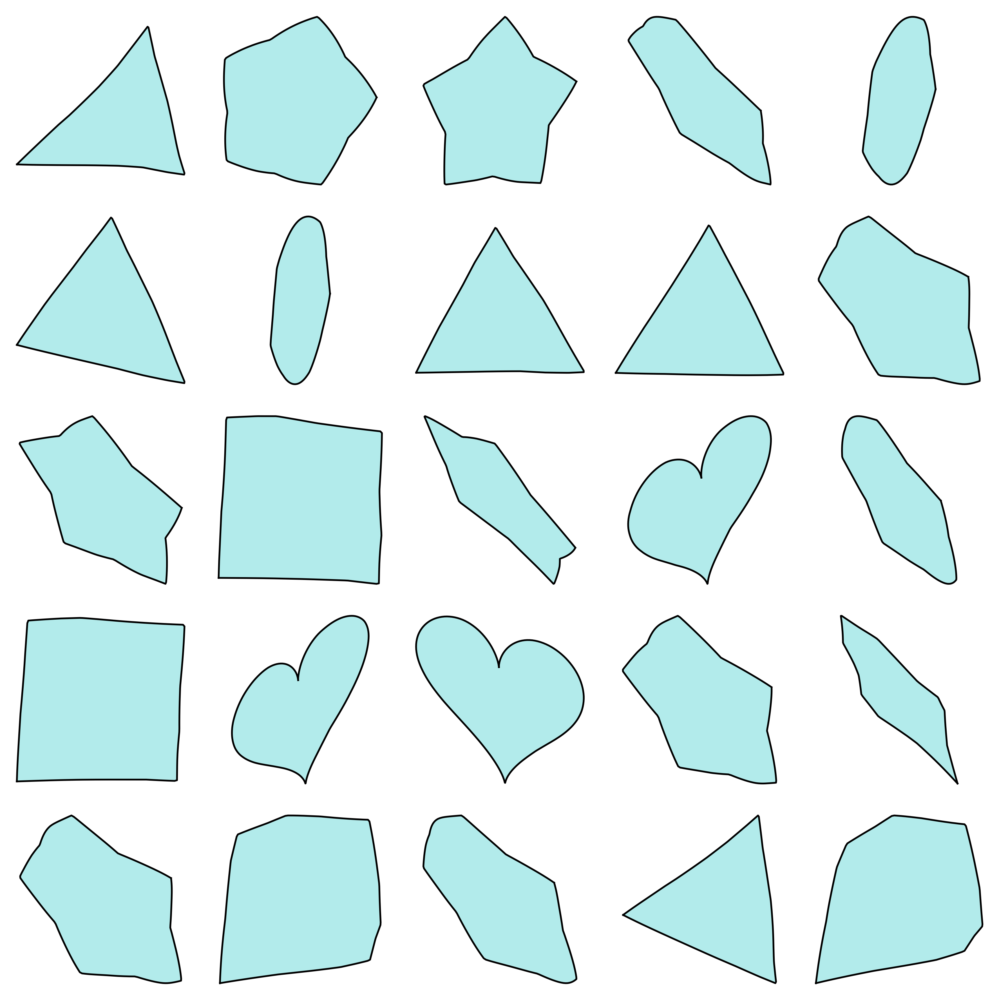

In [1078]:
population.plot()

In [1079]:
ga = pyga.GeneticAlgorithm(population, 
                           num_generations=100, 
                           num_parents=10, 
                           
                           mutation_probability=0.05, 
                           animate=False)

In [1080]:
ga.evolve()

Evolution: 100%|██████████| 100/100 [00:00<00:00, 117.15it/s]


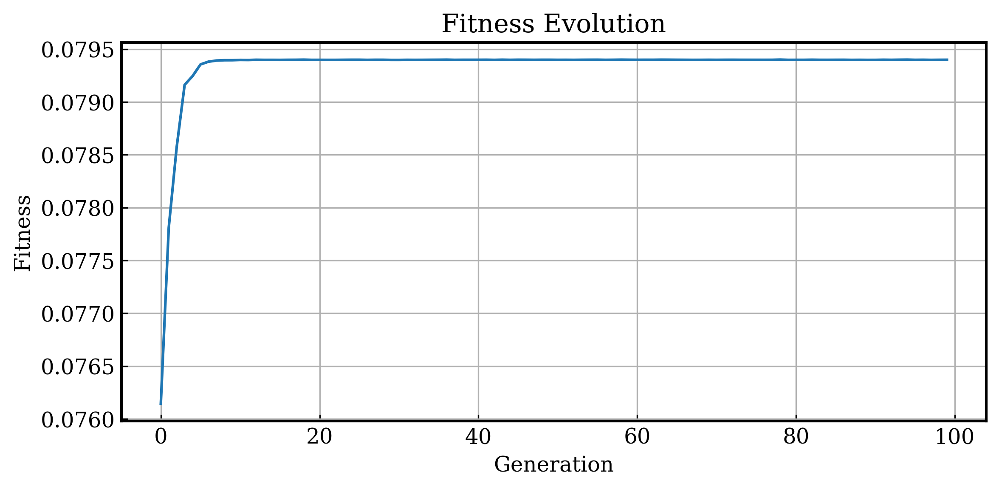

In [1081]:
ga.plot_fitness()

In [1082]:
np.array(population.fitness).max()

np.float32(0.079399355)

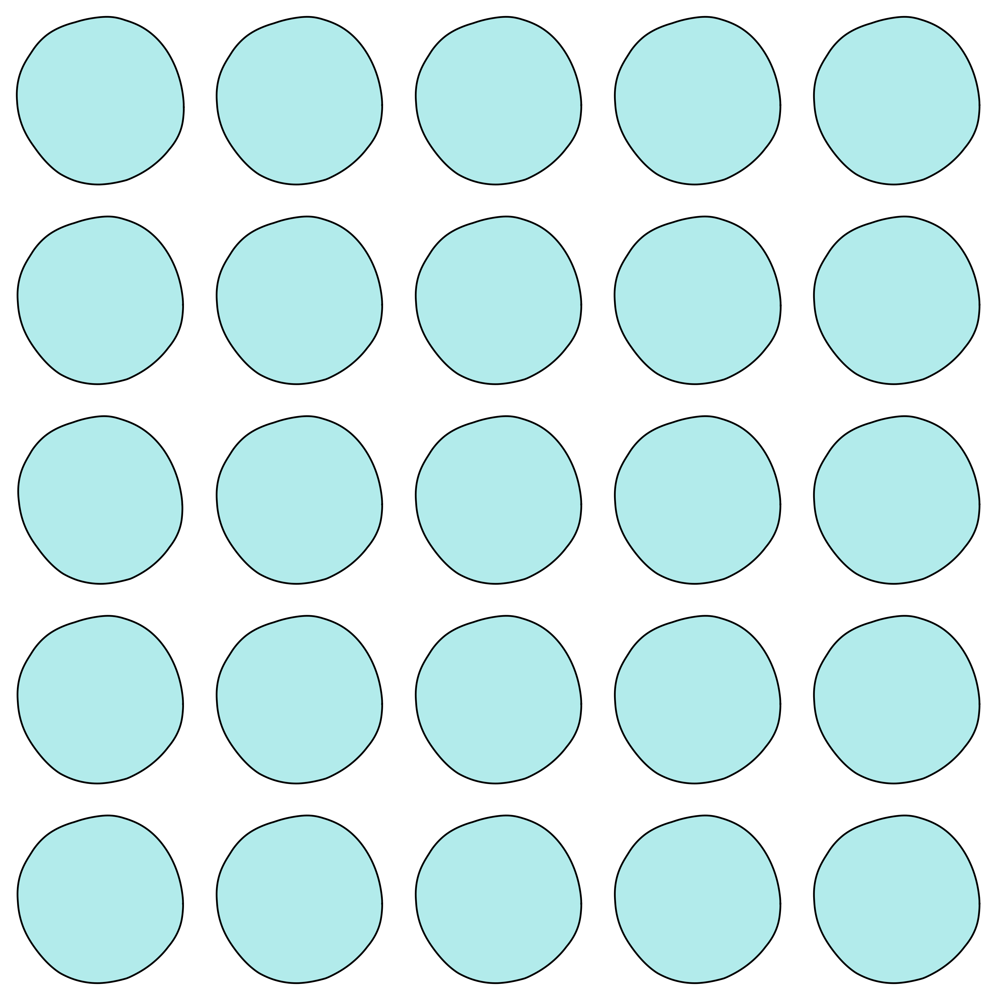

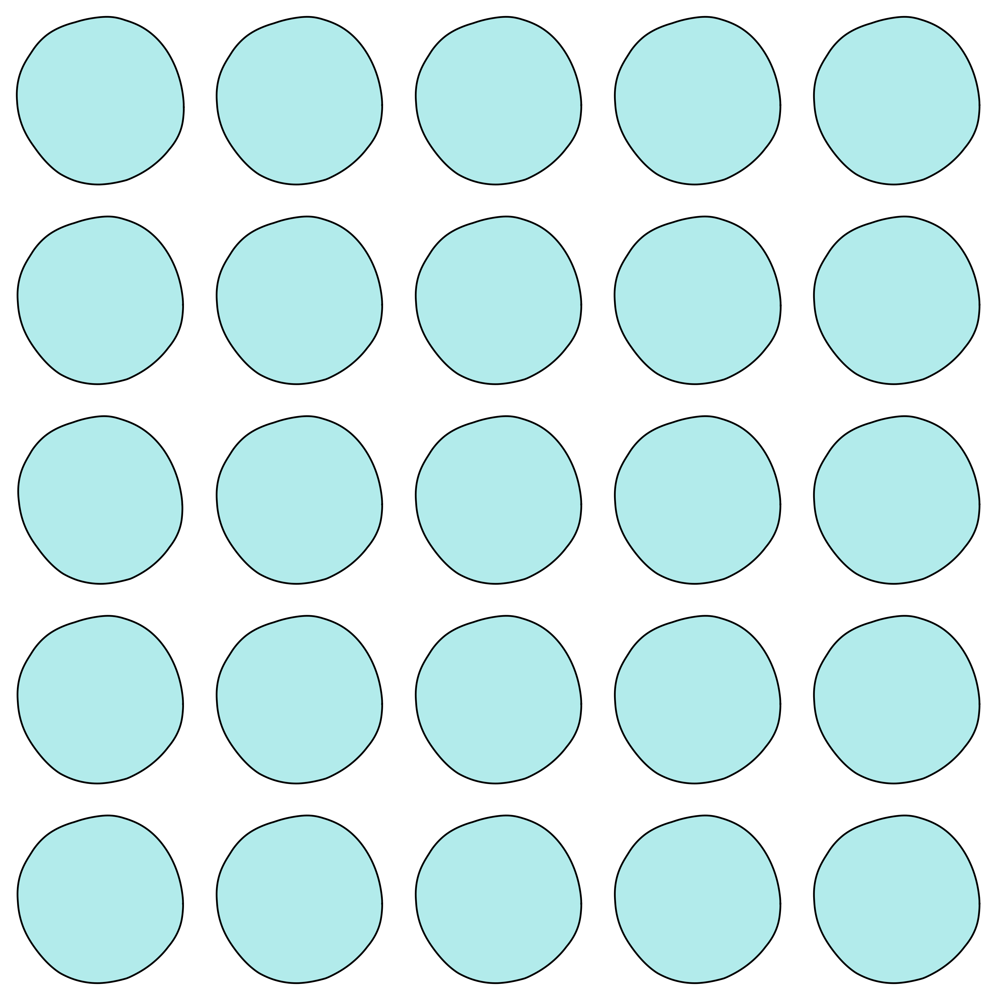

In [1083]:
population.plot()

### Consistent shape set between VAE & Original

In [1135]:
sh = [ShapeOrig(model.decoder(torch.tensor(shape.genes,dtype=torch.float32)).detach().numpy()) for shape in individuals]
population = pyga.Population(sh)

RuntimeError: mat1 and mat2 shapes cannot be multiplied (1x200 and 6x128)

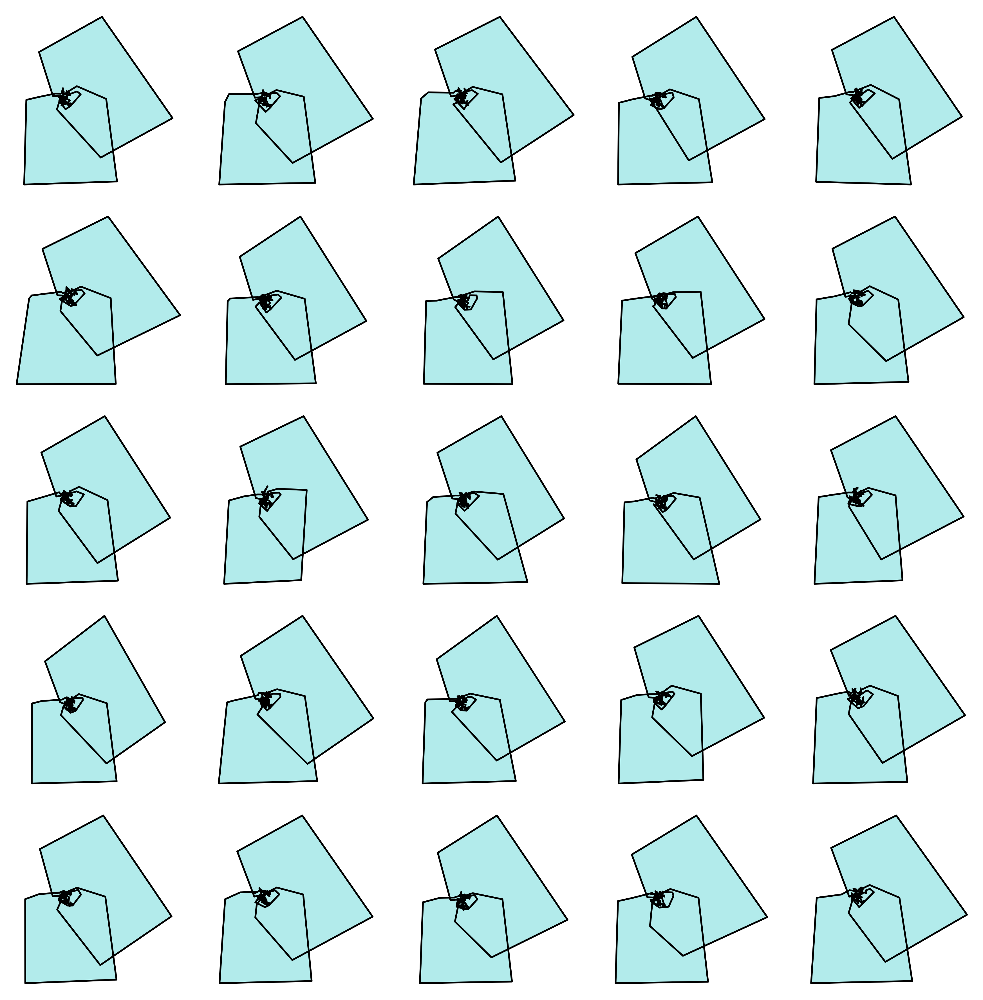

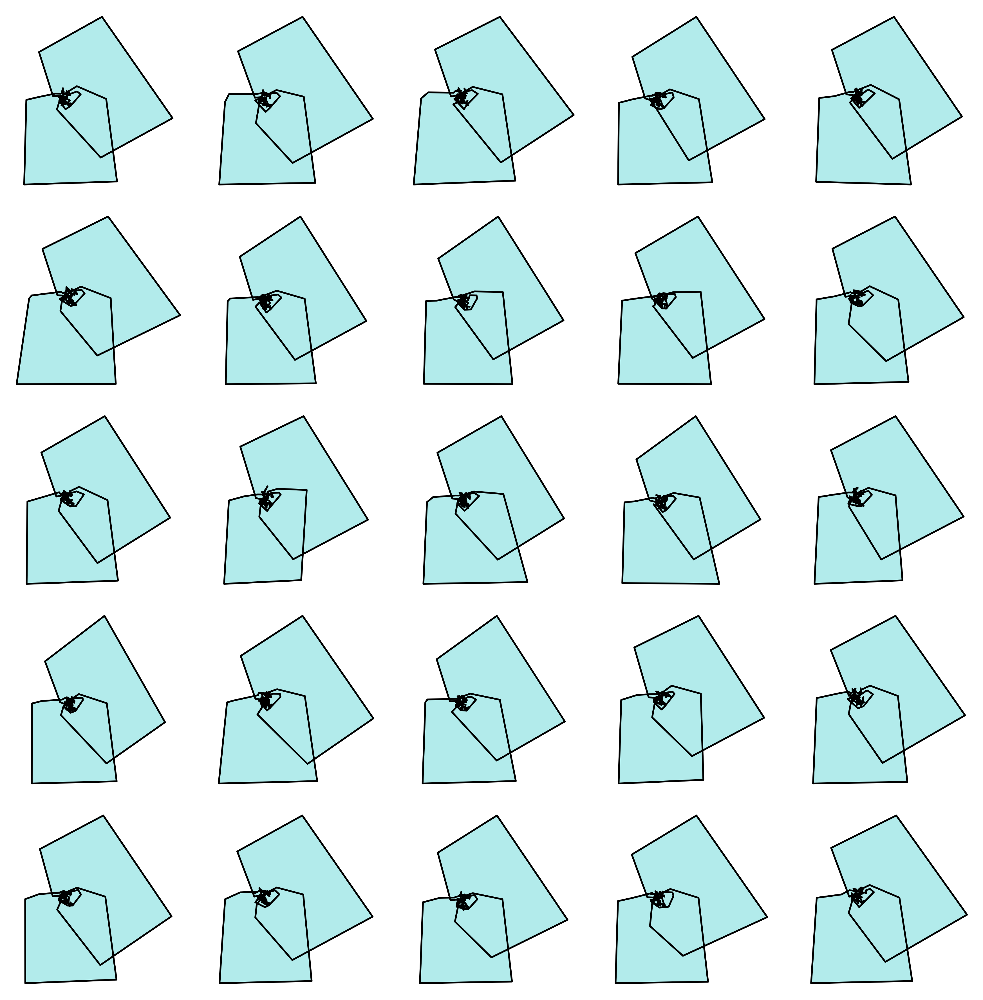

In [1136]:
population.plot()

In [1133]:
ga = pyga.GeneticAlgorithm(population, 
                           num_generations=100, 
                           num_parents=10, 
                           mutation_probability=0.1, 
                           animate=False)

In [1134]:
ga.evolve()

Evolution: 100%|██████████| 100/100 [00:01<00:00, 63.06it/s]


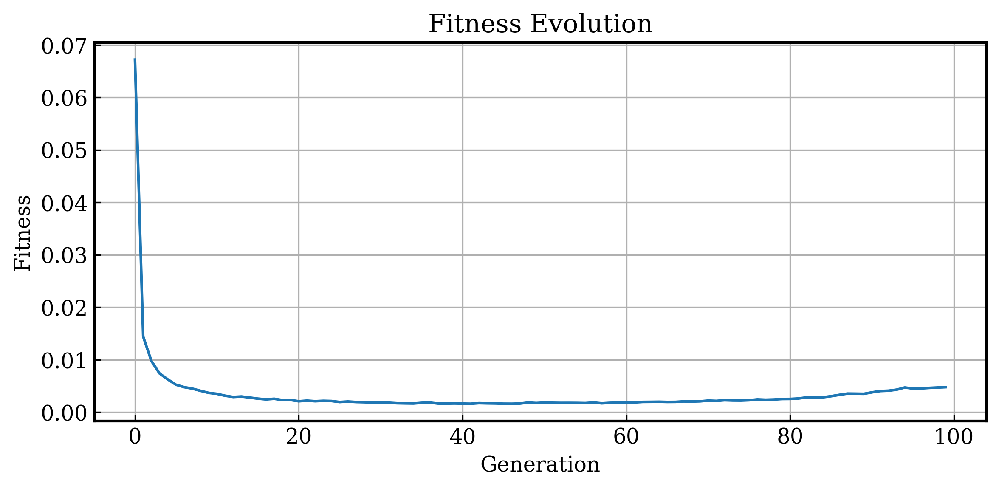

In [1102]:
ga.plot_fitness()

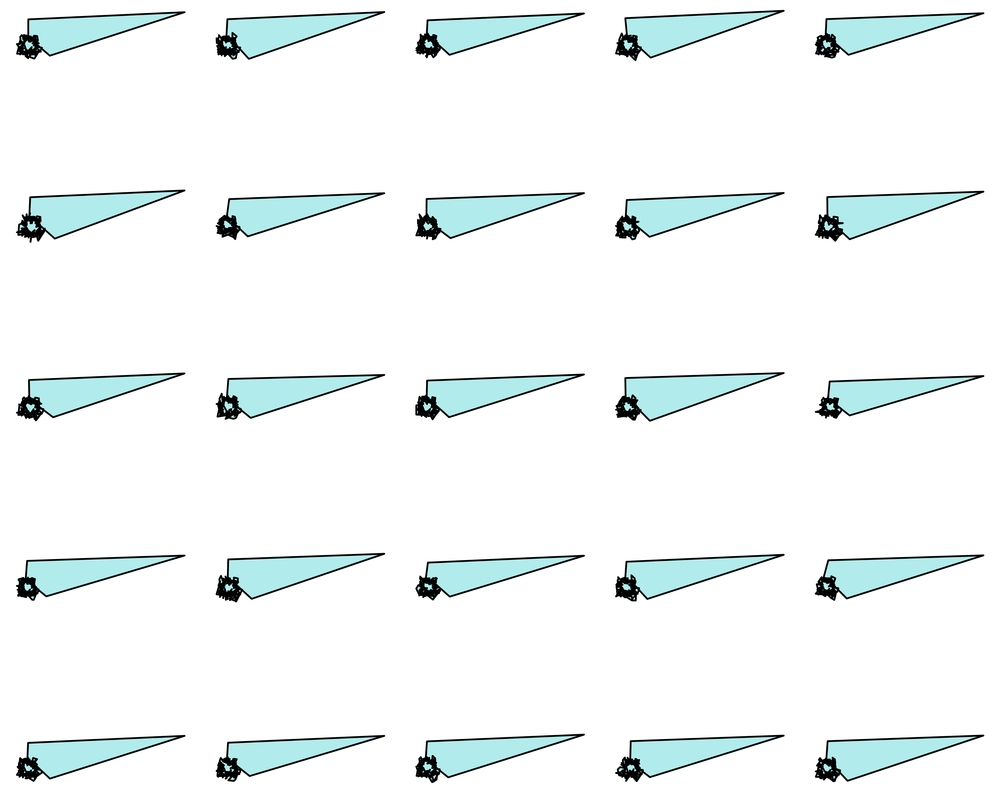

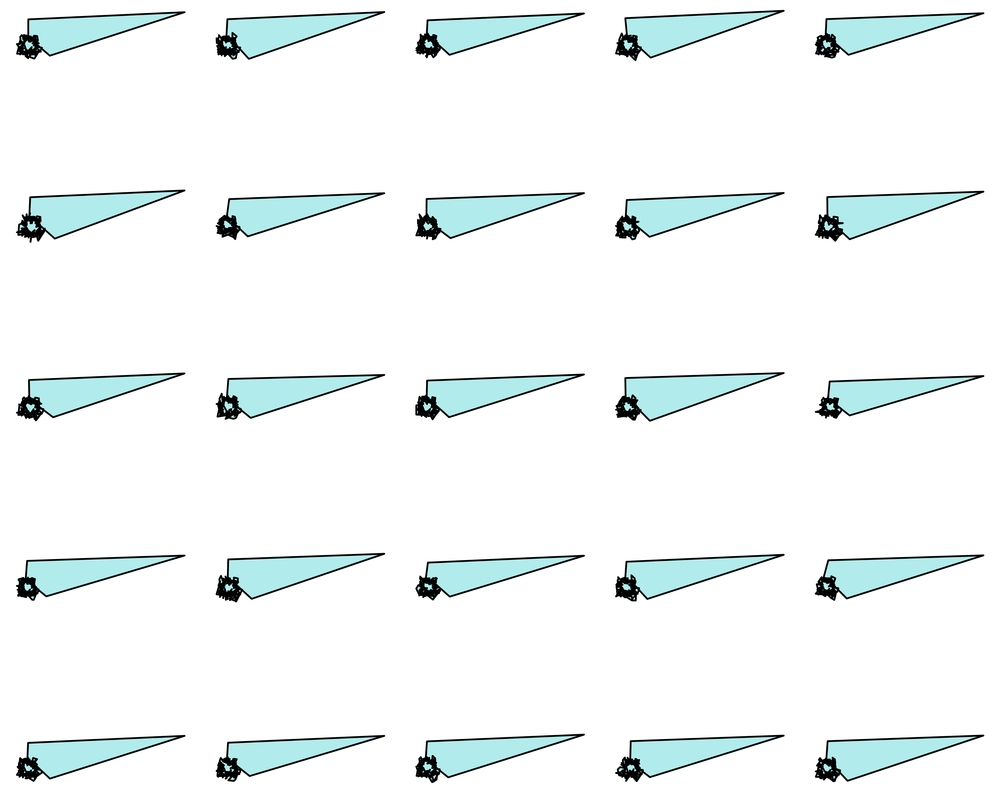

In [1103]:
population.plot()

## Closed Noisy Ring
* Sometimes, in engineering, we may have have previous design knowledge that directs the design in a certain way.
* For example, rather than starting from a random combination of nodes, we may apply the constraint that the nodes of a 2D shape loosely follow a ring.
* This example shows the generation of a random set of shapes defined as 200 nodes, around a centre pont with noise added.

In [1158]:
import numpy as np
import matplotlib.pyplot as plt

def generate_closed_noisy_shape(num_points=100, radius=0.4, noise_scale=0.01):
    # Step 1: Generate a noisy ring
    base_points = num_points - 1  # we'll add the last point manually to match the first
    angles = np.linspace(0, 2 * np.pi, base_points, endpoint=False)
    noise = np.random.normal(0, noise_scale, size=base_points)
    noisy_radius = radius + noise
    x = noisy_radius * np.cos(angles)
    y = noisy_radius * np.sin(angles)
    shape = np.stack((x, y), axis=1)

    # Step 2: Apply random rotation
    theta = np.random.uniform(0, 2 * np.pi)
    rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)],
                                [np.sin(theta),  np.cos(theta)]])
    shape = shape @ rotation_matrix.T

    # Step 3: Apply random skew (shear)
    skew_x = np.random.uniform(-0.75, 0.75)
    skew_y = np.random.uniform(-0.75, 0.75)
    shear_matrix = np.array([[1, skew_x],
                             [skew_y, 1]])
    shape = shape @ shear_matrix.T

    # Step 4: Normalize to [0, 1]
    min_vals = shape.min(axis=0)
    max_vals = shape.max(axis=0)
    shape = (shape - min_vals) / (max_vals - min_vals + 1e-8)

    # Step 5: Close the loop by appending the first point
    shape = np.vstack([shape, shape[0]])

    return shape  # shape is now (200, 2)

# Generate 100 shapes
num_shapes = 100
shapes = np.array([generate_closed_noisy_shape() for _ in range(num_shapes)])  # Shape: (100, 200, 2)

# # Optional: Visualize a few
# for i in range(3):
#     plt.plot(shapes[i, :, 0], shapes[i, :, 1])
#     plt.gca().set_aspect('equal')
#     plt.title(f'Shape {i+1}')
#     plt.show()


In [1159]:
individuals = [ShapeOrig(i.flatten()) for i in shapes]
population = pyga.Population(individuals)

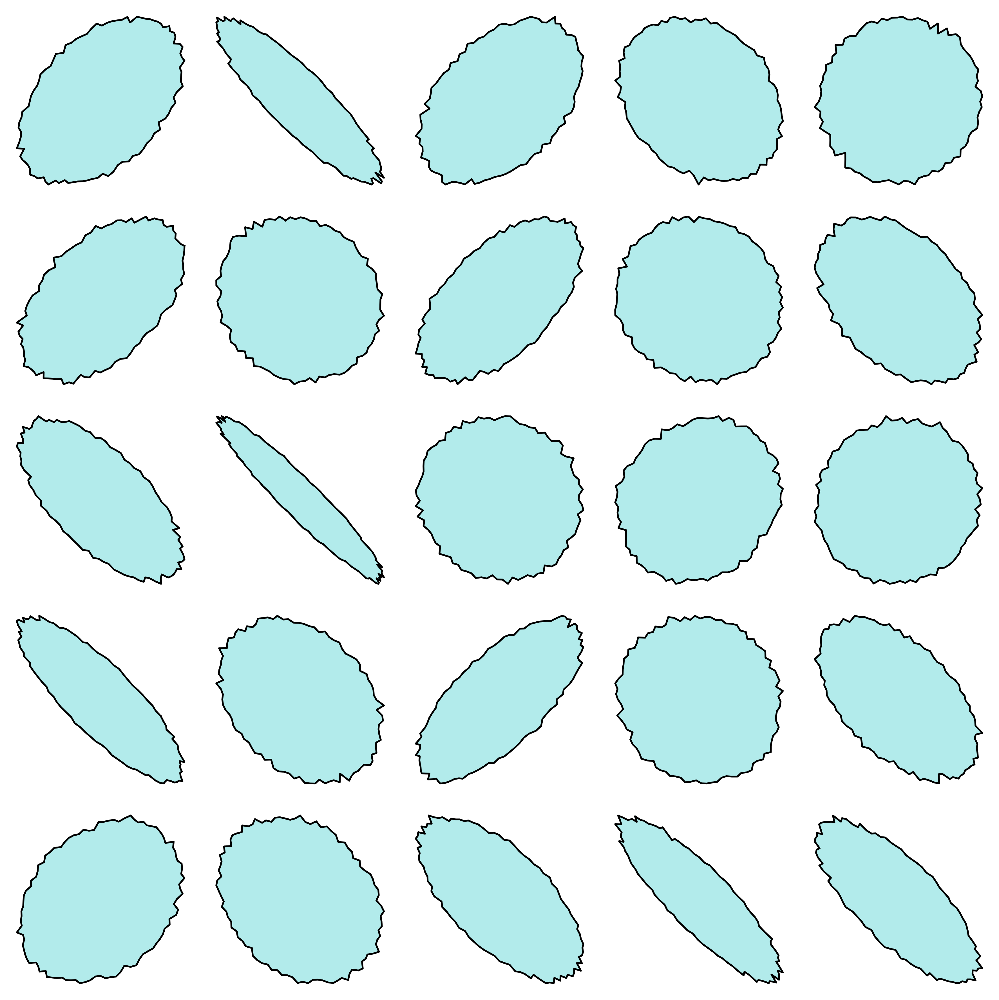

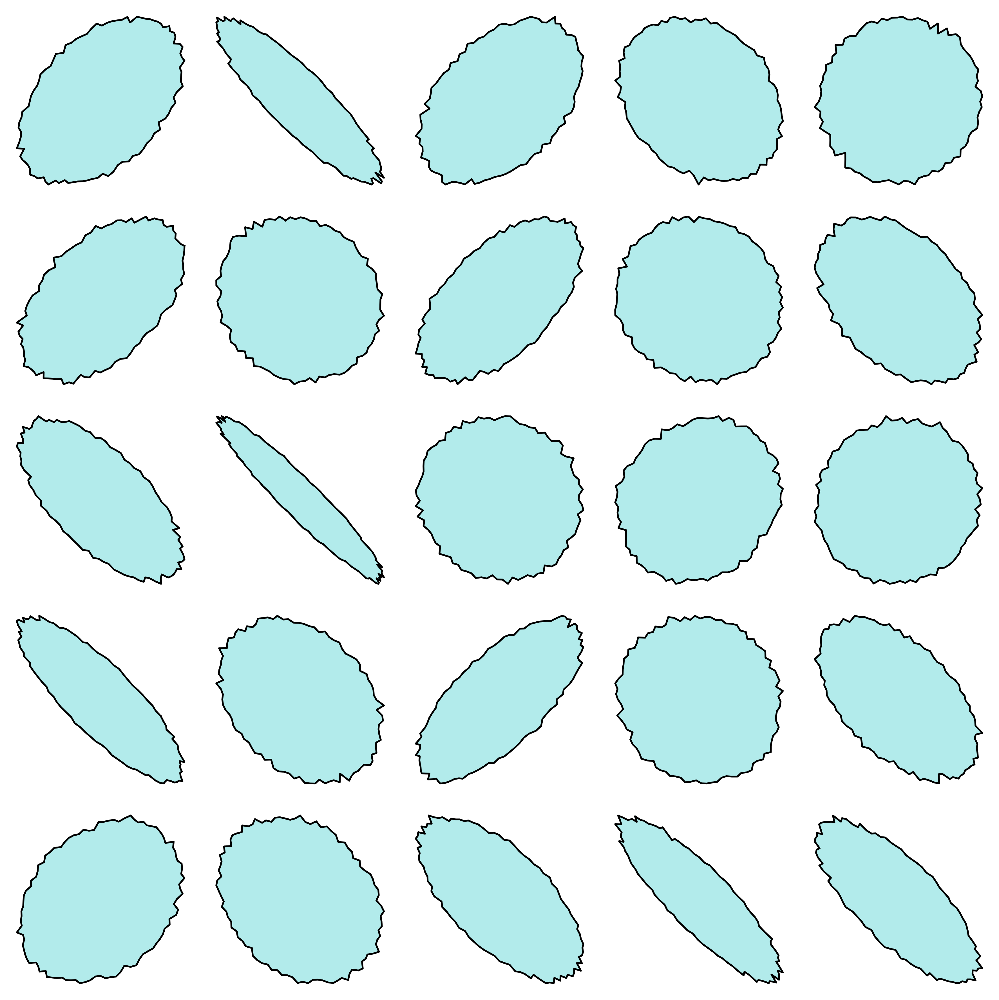

In [1160]:
# Show some of the random generated shapes.
population.plot()

In [1161]:
ga = pyga.GeneticAlgorithm(population, 
                           num_generations=1000, 
                           num_parents=10, 
                           mutation_probability=0.05, 
                           animate=False)

In [1162]:
ga.evolve()

Evolution: 100%|██████████| 1000/1000 [00:28<00:00, 35.23it/s]


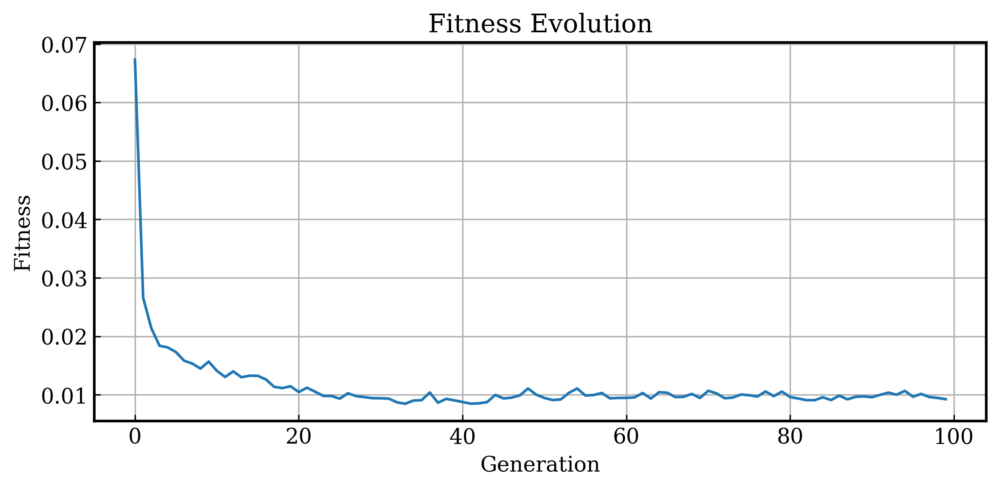

In [1153]:
ga.plot_fitness()

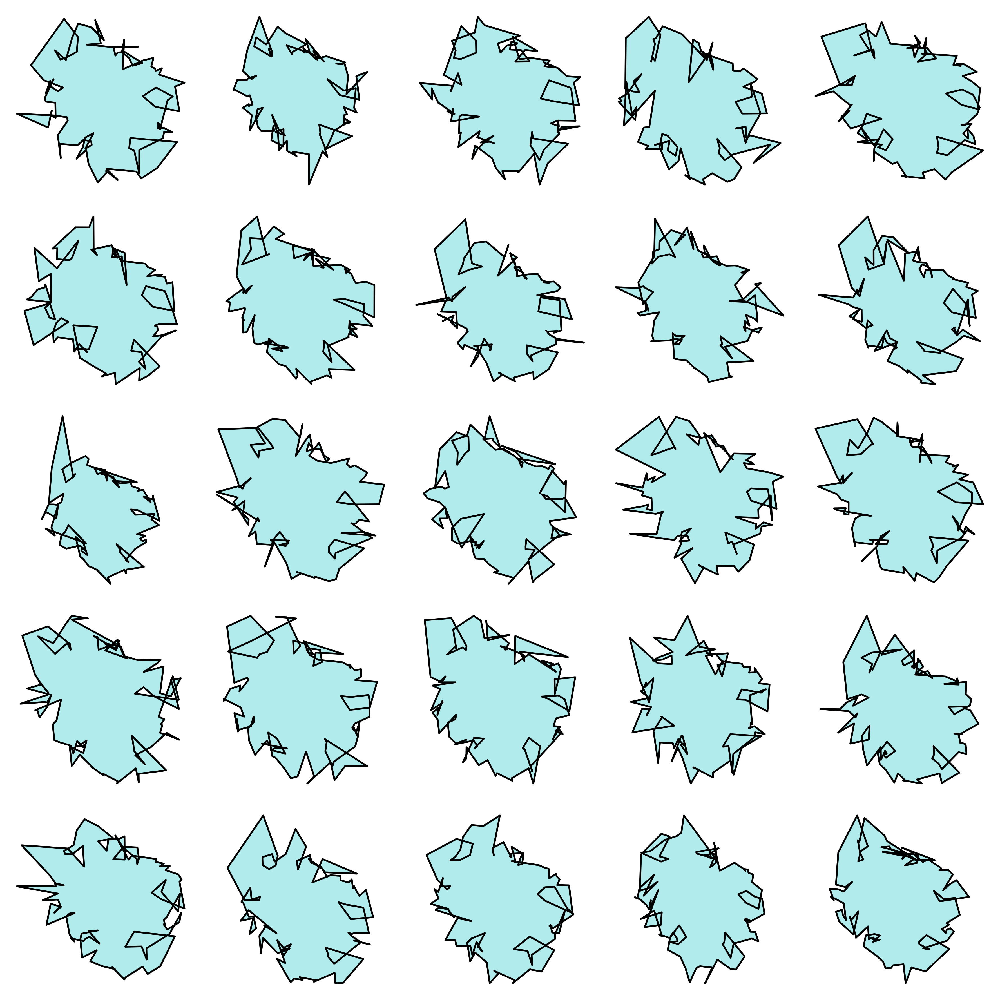

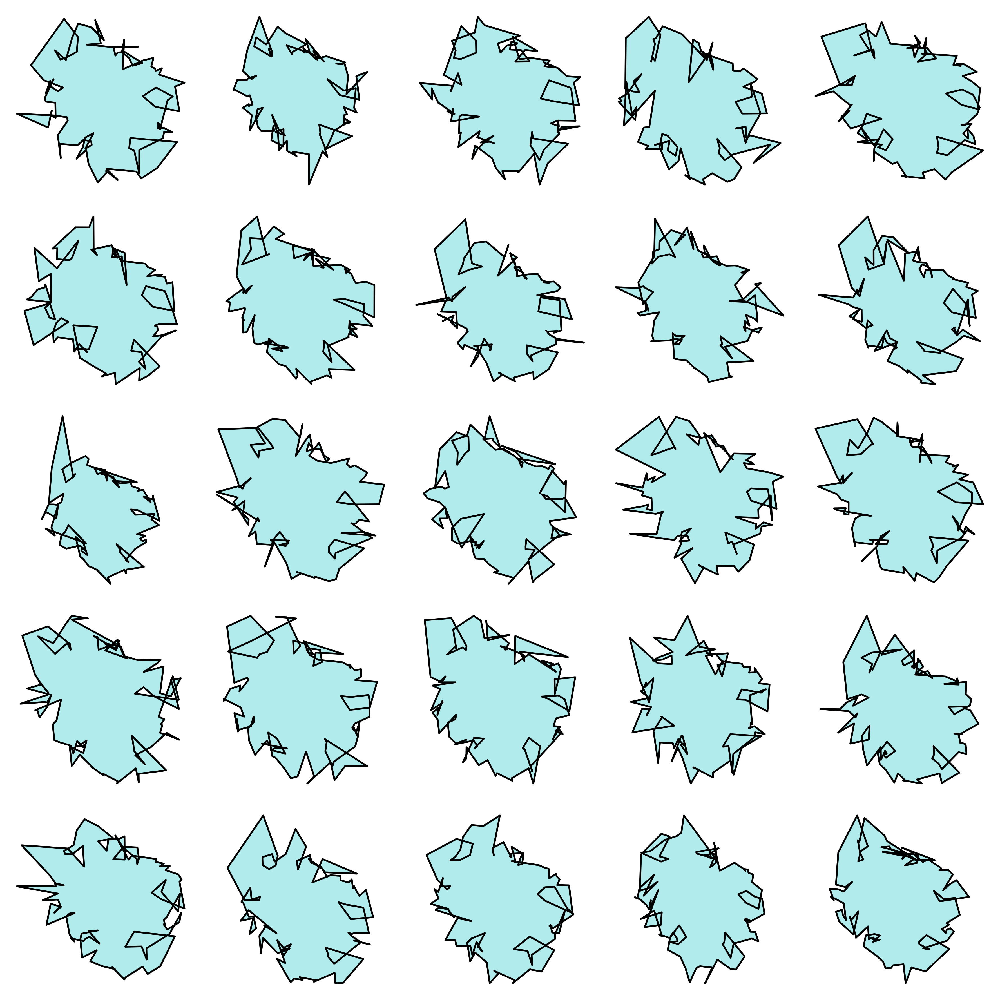

In [1154]:
population.plot()